<a href="https://colab.research.google.com/github/Anant-mishra1729/YOLOv10-Drone-detection/blob/main/Yolov10_drone_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip -q install opendatasets

In [ ]:
import opendatasets as od

DATASET_URL = "https://www.kaggle.com/datasets/dasmehdixtr/drone-dataset-uav"
od.download(DATASET_URL)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: amishra1769
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/dasmehdixtr/drone-dataset-uav


100%|██████████| 716M/716M [00:11<00:00, 65.3MB/s]


## Making dataset compatible with Yolo format

The typical structure follows a clear hierarchy, like this:

```
Data
|-- data.yaml
|-- train
|   |-- images
|   `-- labels
|-- test
|   |-- images
|   `-- labels
`-- val
    |-- images
    `-- labels
```

* `data.yaml (Configuration File):` This file holds crucial settings for the training process, such as the paths to images and labels, along with other parameters relevant to your specific YOLO implementation.
* `train (Train Split):` This folder houses two subfolders:
    * images: This subfolder stores the images you'll use to train YOLO model.
    * labels: This subfolder contains corresponding label files.
    
Similarly for `test (Test split` and `val (Validation Split)`

In [ ]:
from pathlib import Path
import os

DATA_DIR = Path("/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt")
print(len(os.listdir(DATA_DIR)))

2719


In [ ]:
images = sorted(list(DATA_DIR.glob("*.jpg")))
print("Total images: ", len(images))
images[:5]

Total images:  1359


[PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0001.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0003.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0004.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0005.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0006.jpg')]

In [ ]:
labels = sorted(list(DATA_DIR.glob("*.txt")))
print("Total labels: ", len(labels))
labels[:5]

Total labels:  1360


[PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0001.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0003.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0004.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0005.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0006.txt')]

## There is difference b/w count of labels and images, finding the redundant label

In [ ]:
set([label_path.stem for label_path in labels]) - set([image_path.stem for image_path in images])

{'classes'}

#### There is a redundant file **"classes.txt"**

In [ ]:
# Reading classes.txt
with open(DATA_DIR/"classes.txt", 'r') as f:
    print(f.read())

drone



In [ ]:
# Removing classes.txt from labels list
FILE_TO_REMOVE = DATA_DIR / "classes.txt"
labels.remove(FILE_TO_REMOVE)

In [ ]:
print("Images: ", len(images), " Labels: ", len(labels))

Images:  1359  Labels:  1359


## Generating dataset in YOLO format

```
Data
|-- data.yaml
|-- train
|   |-- images
|   `-- labels
|-- test
|   |-- images
|   `-- labels
`-- val
    |-- images
    `-- labels
```

### Creating directories and copying files

In [ ]:
DATA_DIR = Path("Data")
TRAIN_DIR = DATA_DIR / "train"
TEST_DIR = DATA_DIR / "test"
VALIDATION_DIR = DATA_DIR / "val"
os.makedirs(TRAIN_DIR/ "images")
os.makedirs(TRAIN_DIR/ "labels")
os.makedirs(TEST_DIR/ "images")
os.makedirs(TEST_DIR/ "labels")
os.makedirs(VALIDATION_DIR/ "images")
os.makedirs(VALIDATION_DIR/ "labels")

In [ ]:
# Splitting data into train and test data
from sklearn.model_selection import train_test_split

X_train,X_temp,y_train,y_temp = train_test_split(images, labels, test_size = 0.2)
X_val,X_test,y_val,y_test = train_test_split(X_temp, y_temp, test_size = 0.2)

In [ ]:
print("Train image count: ", len(X_train))
print("Validation image count: ", len(X_val))
print("Test image count: ", len(X_test))

Train image count:  1087
Validation image count:  217
Test image count:  55


In [ ]:
X_train[:5], y_train[:5]

([PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/yoto06497.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_650.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_506.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_050.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_723.jpg')],
 [PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/yoto06497.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_650.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_506.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_050.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_723.txt')])

In [ ]:
import shutil
from tqdm.notebook import tqdm

def copyfiles(files, dest):
    print(f"Copying files to {dest}")
    for file in tqdm(files):
        shutil.copy(file, dest)

copyfiles(X_train, TRAIN_DIR/ "images")
copyfiles(y_train, TRAIN_DIR/ "labels")

copyfiles(X_test, TEST_DIR/ "images")
copyfiles(y_test, TEST_DIR/ "labels")

copyfiles(X_val, VALIDATION_DIR/ "images")
copyfiles(y_val, VALIDATION_DIR/ "labels")

Copying files to Data/train/images


  0%|          | 0/1087 [00:00<?, ?it/s]

Copying files to Data/train/labels


  0%|          | 0/1087 [00:00<?, ?it/s]

Copying files to Data/test/images


  0%|          | 0/55 [00:00<?, ?it/s]

Copying files to Data/test/labels


  0%|          | 0/55 [00:00<?, ?it/s]

Copying files to Data/val/images


  0%|          | 0/217 [00:00<?, ?it/s]

Copying files to Data/val/labels


  0%|          | 0/217 [00:00<?, ?it/s]

## Creating configuration file `data.yaml`

In [ ]:
data_yaml = """
train: /content/Data/train/images
test: /content/Data/test/images
val: /content/Data/val/images

names:
  0: drone
"""

with open(DATA_DIR/"data.yaml", "w") as f:
    f.write(data_yaml)

In [ ]:
os.listdir(DATA_DIR)

['test', 'val', 'train', 'data.yaml']

In [ ]:
with open(DATA_DIR/"data.yaml", "r") as f:
    print(f.read())


train: /content/Data/train/images
test: /content/Data/test/images
val: /content/Data/val/images

names:
  0: drone



In [ ]:
!zip -r /content/dataset.zip /content/Data

  adding: content/Data/ (stored 0%)
  adding: content/Data/test/ (stored 0%)
  adding: content/Data/test/labels/ (stored 0%)
  adding: content/Data/test/labels/pic_536.txt (deflated 8%)
  adding: content/Data/test/labels/pic_710.txt (deflated 11%)
  adding: content/Data/test/labels/foto01538.txt (deflated 7%)
  adding: content/Data/test/labels/scene00016.txt (deflated 13%)
  adding: content/Data/test/labels/pic_746.txt (deflated 19%)
  adding: content/Data/test/labels/pic_118.txt (deflated 11%)
  adding: content/Data/test/labels/pic_089.txt (deflated 12%)
  adding: content/Data/test/labels/scene00721.txt (deflated 8%)
  adding: content/Data/test/labels/pic_299.txt (deflated 8%)
  adding: content/Data/test/labels/pic_1152.txt (deflated 40%)
  adding: content/Data/test/labels/0283.txt (deflated 11%)
  adding: content/Data/test/labels/pic_767.txt (deflated 14%)
  adding: content/Data/test/labels/pic_078.txt (deflated 15%)
  adding: content/Data/test/labels/pic_551.txt (deflated 14%)
  add

In [ ]:
from google.colab import files
files.download("/content/dataset.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Installing requirements

In [ ]:
!pip install -q git+https://github.com/THU-MIG/yolov10.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 39.4 MB/s eta 0:00:00


## Downloading weights

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
!mkdir -p {HOME}/weights
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10n.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10s.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10m.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10b.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10x.pt
!wget -P {HOME}/weights -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10l.pt
!ls -lh {HOME}/weights

total 408M
-rw-r--r-- 1 root root  80M May 26 15:53 yolov10b.pt
-rw-r--r-- 1 root root 100M May 26 15:53 yolov10l.pt
-rw-r--r-- 1 root root  64M May 26 15:54 yolov10m.pt
-rw-r--r-- 1 root root  11M May 26 15:54 yolov10n.pt
-rw-r--r-- 1 root root  32M May 26 15:54 yolov10s.pt
-rw-r--r-- 1 root root 123M May 26 15:54 yolov10x.pt


## Training the model

In [ ]:
%cd {HOME}

!yolo task=detect mode=train epochs=20 batch=64 plots=True \
model={HOME}/weights/yolov10n.pt \
data={DATA_DIR}/data.yaml

/content
New https://pypi.org/project/ultralytics/8.2.31 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/weights/yolov10n.pt, data=Data/data.yaml, epochs=20, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, val_period=1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, em

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## Plotting validation metrics

(-0.5, 2999.5, 2249.5, -0.5)

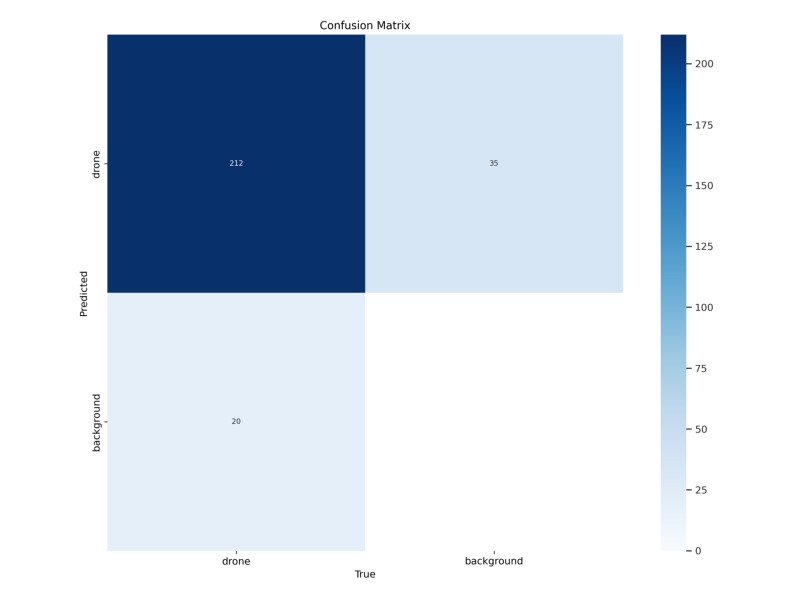

In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

cnf = Image.open("runs/detect/train/confusion_matrix.png")
plt.figure(figsize = (10,10))
plt.imshow(np.asarray(cnf))
plt.axis('off')

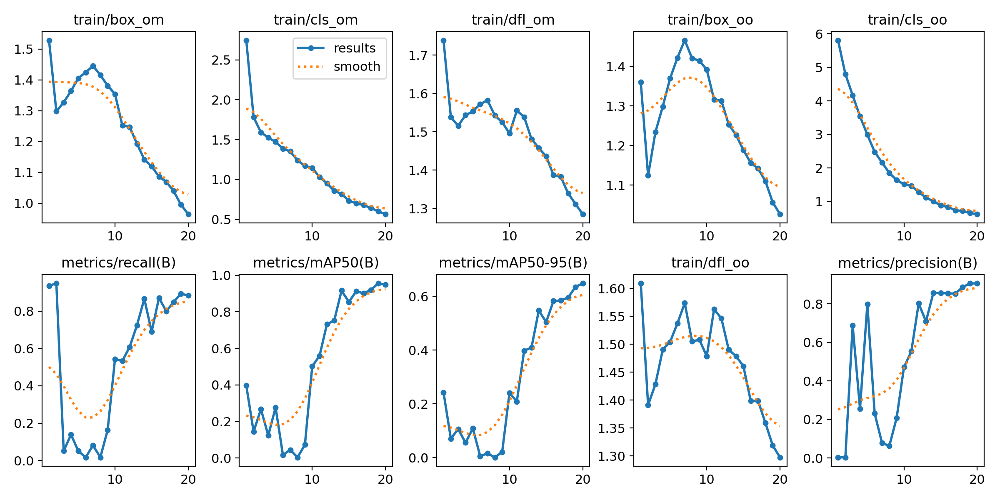

In [ ]:
from IPython import display
display.Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

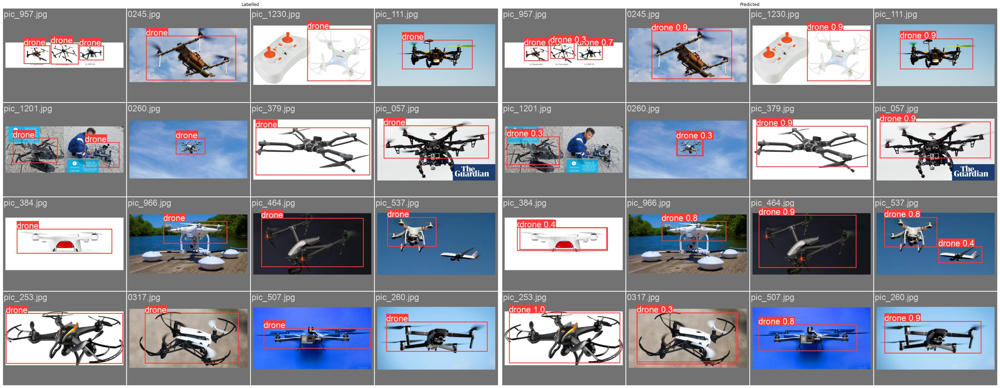

In [ ]:
def show_pred(labelled_path, pred_path):
    plt.figure(figsize = (40,20))
    labelled = Image.open(labelled_path)
    predicted = Image.open(pred_path)
    plt.subplot(121)
    plt.title("Labelled")
    plt.imshow(np.asarray(labelled))
    plt.axis("off")
    plt.subplot(122)
    plt.title("Predicted")
    plt.imshow(np.asarray(predicted))
    plt.axis("off")
    plt.tight_layout()

show_pred("runs/detect/train/val_batch0_labels.jpg", "runs/detect/train/val_batch0_pred.jpg")

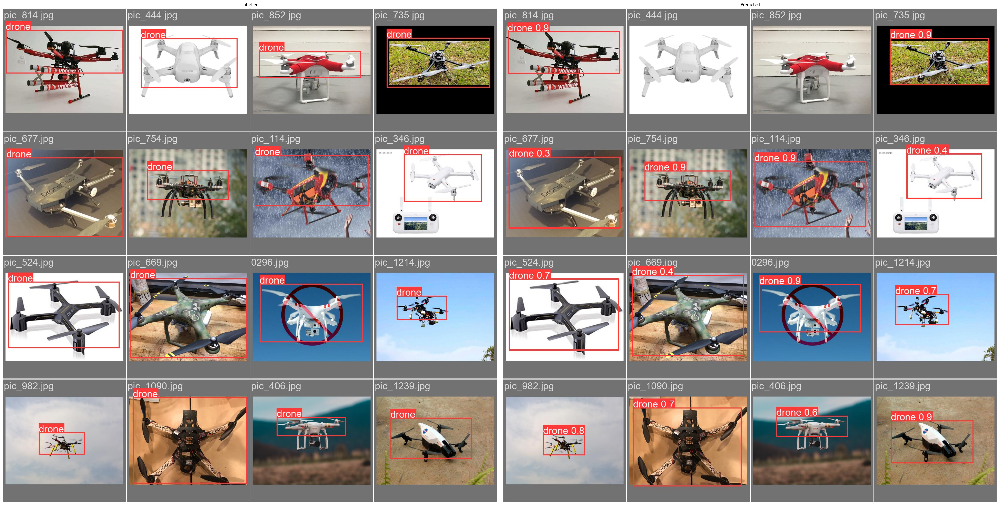

In [ ]:
show_pred("runs/detect/train/val_batch1_labels.jpg", "runs/detect/train/val_batch1_pred.jpg")

## Generating results on test data

In [ ]:
!pip -q install supervision

In [ ]:
from ultralytics import YOLOv10

model = YOLOv10(f'{HOME}/runs/detect/train/weights/best.pt')

model.info()

YOLOv10n summary: 385 layers, 2707430 parameters, 0 gradients, 8.4 GFLOPs


(385, 2707430, 0, 8.3940352)

In [ ]:
test_results = model.val(data=DATA_DIR/"data.yaml", split="test")

Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2694806 parameters, 0 gradients, 8.2 GFLOPs


val: Scanning /content/Data/test/labels... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<00:00, 191.88it/s]

val: New cache created: /content/Data/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.14s/it]


                   all         55         77      0.851       0.74      0.859      0.584
Speed: 10.1ms preprocess, 31.7ms inference, 0.0ms loss, 3.9ms postprocess per image
Results saved to runs/detect/val


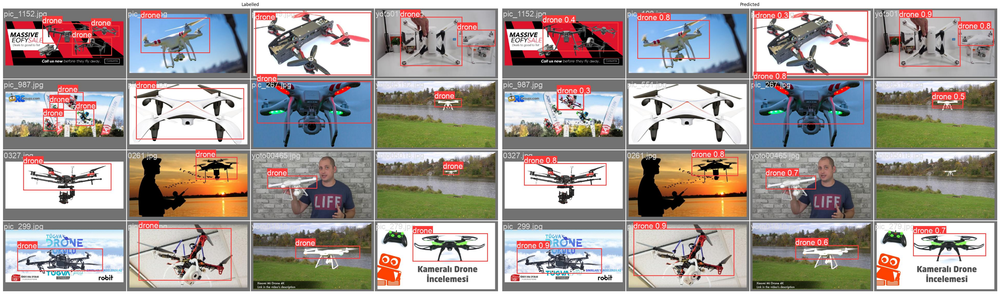

In [ ]:
show_pred("runs/detect/val/val_batch0_labels.jpg", "runs/detect/val/val_batch0_pred.jpg")

## Predicting on random image

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!wget "https://res.cloudinary.com/engineering-com/image/upload/w_640,h_640,c_limit/Drone_Army_bloy3t.jpg"

--2024-06-12 03:05:44--  https://res.cloudinary.com/engineering-com/image/upload/w_640,h_640,c_limit/Drone_Army_bloy3t.jpg
Resolving res.cloudinary.com (res.cloudinary.com)... 104.19.166.65, 104.19.167.65, 2600:1408:c400:158b::523, ...
Connecting to res.cloudinary.com (res.cloudinary.com)|104.19.166.65|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 28598 (28K) [image/jpeg]
Saving to: ‘Drone_Army_bloy3t.jpg’

Drone_Army_bloy3t.j 100%[===================>]  27.93K  --.-KB/s    in 0s      

2024-06-12 03:05:45 (95.7 MB/s) - ‘Drone_Army_bloy3t.jpg’ saved [28598/28598]



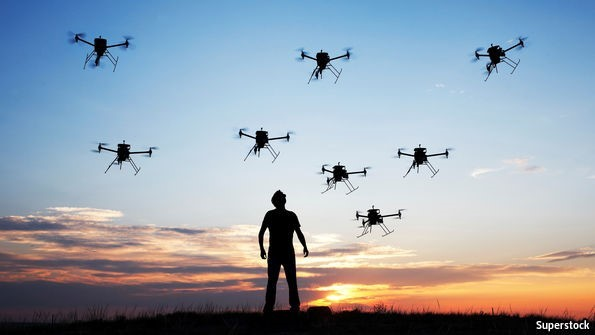

In [ ]:
test_image = Image.open("Drone_Army_bloy3t.jpg")
test_image

In [ ]:
test_image_results = model(test_image)[0]


0: 384x640 9 drones, 129.1ms
Speed: 2.3ms preprocess, 129.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


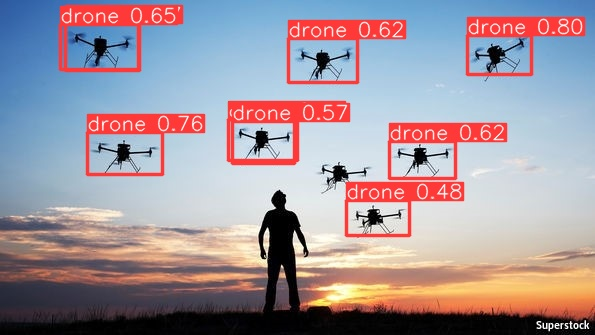

In [ ]:
test_image_results.save("test_image_result.jpg")
Image.open("test_image_result.jpg")

## Downloading best weights



In [ ]:
from google.colab import files
files.download('/content/runs/detect/train/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Predicting on a video

In [ ]:
results = model.track("test_video.mp4", save=True)

requirements: Ultralytics requirement ['lapx>=0.5.2'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 24.9 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 8.5s, installed 1 package: ['lapx>=0.5.2']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/360) /content/test_video.mp4: 384x640 2 drones, 42.9ms
video 1/1 (frame 2/360) /content/test_video.mp4: 384x640

In [ ]:
!ffmpeg -i /content/runs/detect/predict/test_video.avi -t 10 video.gif

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

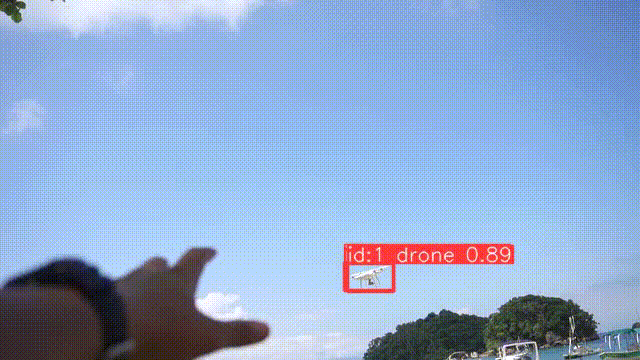

In [ ]:
fname = 'video.gif'
display.Image(open(fname, 'rb').read())